# Exercises XP Gold

## Exercise 1: Creating a Scatter Plot with Aesthetic Mappings

### Objective:

Use plotnine to create a scatter plot from a given dataset. The plot should map at least two variables to the x and y-axes and include an aesthetic mapping for color based on a third variable.
### Instructions

* Load your dataset into a pandas DataFrame.
* Import the necessary components from plotnine.
* Create a scatter plot using geom_point() where you map the x-axis to one variable and the y-axis to another.
* Add an aesthetic mapping to color the points based on a third variable.
* Customize the labels and title of the plot.
* Display the plot.


In [1]:
import pandas as pd
import numpy as np
import pandas as pd

from plotnine import *
from plotnine.data import *
import plotly.express as px
import plotly.subplots as sp

from sklearn.datasets import load_iris

In [2]:
iris = load_iris()
df = pd.DataFrame(data=iris.data, columns=iris.feature_names)

# categorize sepal length so we have categrical data
df['sepal_length_category'] = pd.cut(df['sepal length (cm)'],
                                    bins=np.linspace(df['sepal length (cm)'].min(),
                                                     df['sepal length (cm)'].max(),
                                                     5), # create 4 bins (plus lower/upper bounds for a total of 5)
                                    labels=['Short', 'Medium', 'Long', 'Very Long'],
                                    include_lowest=True) # include lower bound of min value

# categorize sepal length so we have categrical data
df['petal_length_category'] = pd.cut(df['petal length (cm)'],
                                    bins=np.linspace(df['petal length (cm)'].min(),
                                                     df['petal length (cm)'].max(),
                                                     5), # create 4 bins (plus lower/upper bounds for a total of 5)
                                    labels=['Short', 'Medium', 'Long', 'Very Long'],
                                    include_lowest=True) # include lower bound of min value
display(df.head())

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),sepal_length_category,petal_length_category
0,5.1,3.5,1.4,0.2,Short,Short
1,4.9,3.0,1.4,0.2,Short,Short
2,4.7,3.2,1.3,0.2,Short,Short
3,4.6,3.1,1.5,0.2,Short,Short
4,5.0,3.6,1.4,0.2,Short,Short


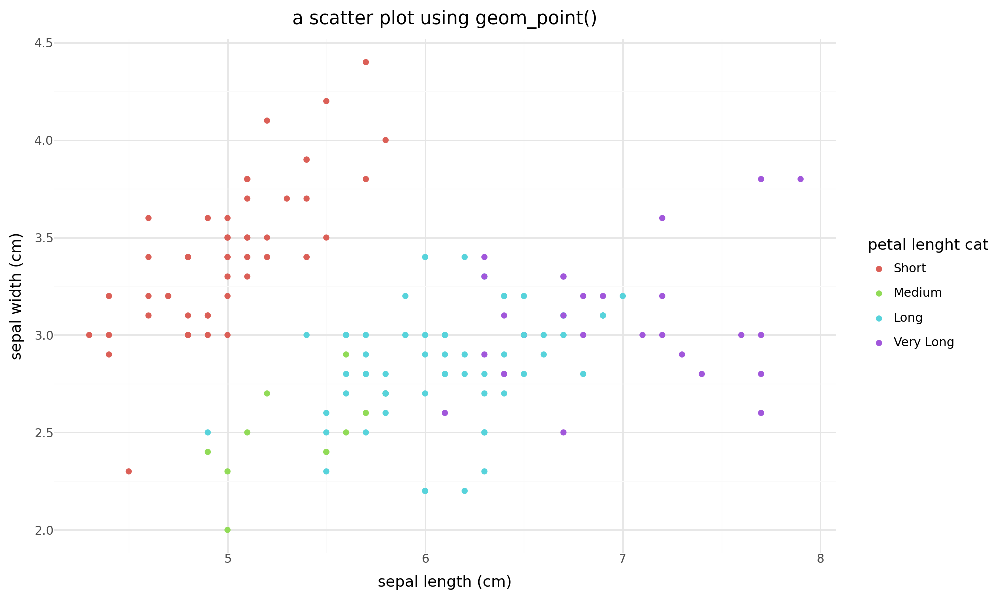

In [3]:
plot = (ggplot(df, aes(x='sepal length (cm)', y='sepal width (cm)', color='petal_length_category'))
 + geom_point()  # need adding scatter plot geometry
 + labs(title="a scatter plot using geom_point()",
        x="sepal length (cm)", y="sepal width (cm)")
 + theme_minimal()
 + theme(figure_size=(10, 6))
 + scale_color_discrete(name="petal lenght cat")
 )

plot

## Exercise 2: Building a Stacked Bar Chart

### Objective

Create a stacked bar chart using plotnine that visualizes the counts of a categorical variable, stacked by another categorical variable.
Instructions

* Load your dataset into a pandas DataFrame.
* Import the necessary components from plotnine.
* Use geom_bar() to create a bar chart. Ensure the bars are stacked.
* Map the x-axis to a categorical variable.
* Use the fill aesthetic to stack the bars based on another categorical variable.
* Add appropriate labels and a title to your chart.
* Display the plot.


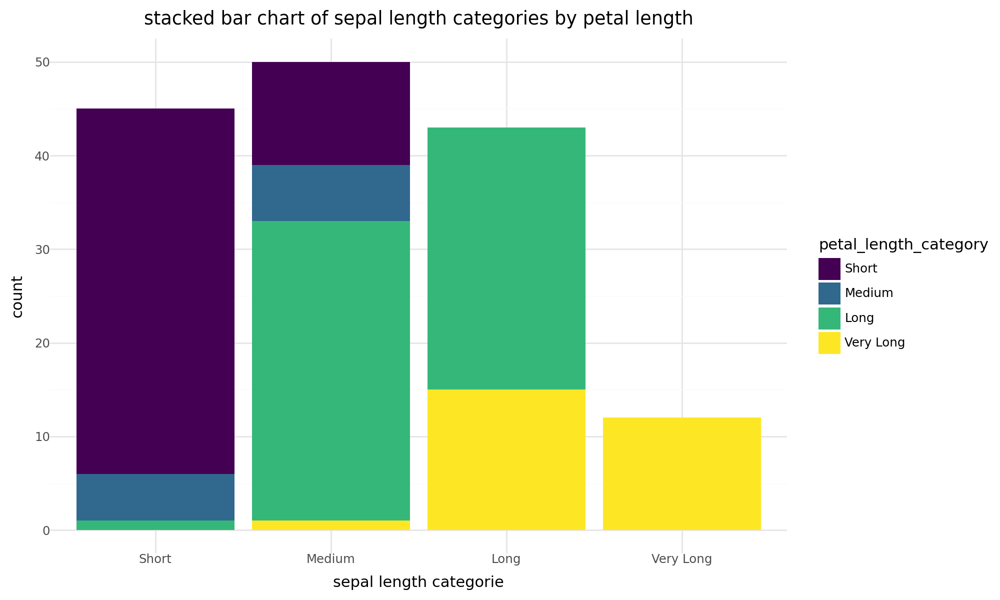

In [4]:
(ggplot(df, aes(x='sepal_length_category', fill='petal_length_category'))
 + geom_bar(position='stack')
 + labs(title='stacked bar chart of sepal length categories by petal length',
        x='sepal length categorie',
        y='count')
 + theme_minimal()
 + theme(figure_size=(10, 6))
)

## Exercise 3: Exploring Facet Wrapping in Plotnine

### Objective:

Use plotnine to create a series of plots for different subsets of your data using facet wrapping.
Instructions

* Load your dataset into a pandas DataFrame.
* Import the necessary components from plotnine.
* Create a basic plot (like a scatter plot or bar chart) using your dataset.
* Apply facet_wrap() to your plot to create multiple panels, each representing a subset of your data based on a specified variable.
* Customize the layout and appearance of the facet grid.
* Add appropriate labels and titles to your plots.
* Display the final plot.


/usr/local/lib/python3.10/dist-packages/plotnine/themes/themeable.py:2426: FutureWarning: You no longer need to use subplots_adjust to make space for the legend or text around the panels. This parameter will be removed in a future version. You can still use 'plot_margin' 'panel_spacing' for your other spacing needs.


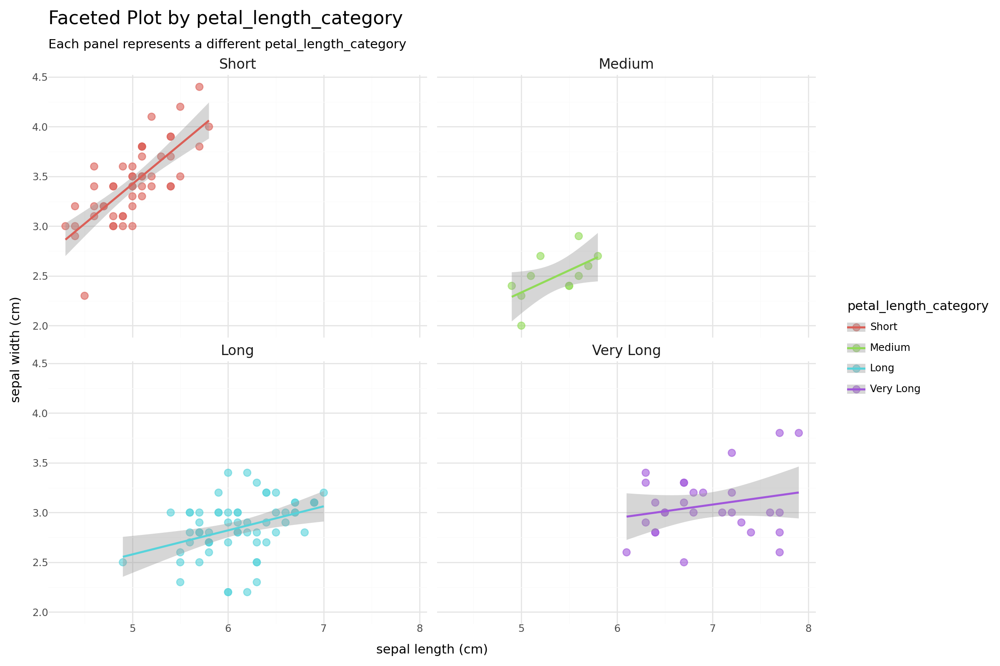

In [5]:
plot = (ggplot(df, aes(x='sepal length (cm)', y='sepal width (cm)', color='petal_length_category')) +
        geom_point(size=3, alpha=0.6) +
        geom_smooth(method='lm', se=True) +
        facet_wrap('~petal_length_category', ncol=2) +  # Set number of columns to 2
        theme_minimal() +
        theme(figure_size=(12, 8),  # Larger figure size for better visibility
              subplots_adjust={'wspace': 0.2, 'hspace': 0.3},  # Adjust spacing
              plot_title=element_text(size=16),
              strip_text=element_text(size=12)) +  # Facet label size
        labs(title="Faceted Plot by petal_length_category",
             subtitle="Each panel represents a different petal_length_category",
             x="sepal length (cm)",
             y="sepal width (cm)",
             color="petal_length_category") +
        scale_color_discrete())

plot

## Exercise 4: Interactive Line Chart with the Gapminder Dataset

### Objective:

Create an interactive line chart using Plotly that visualizes the GDP per capita over time for a selected country from the Gapminder dataset.
Instructions

* Load the [GapMinder - Income Inequality Dataset](https://github.com/devtlv/Datasets-DA-Bootcamp-2-/raw/refs/heads/main/Week%205%20-%20Data%20Processing/W5D3%20-%20Comprehensive%20Course/GapMinder%20-%20Income%20Inequality.rar) into a pandas DataFrame.
* Import the necessary components from `plotly`.
* Filter the dataset for a specific country of your choice.
* Create a line chart that plots year on the x-axis and GDP per capita on the y-axis.
* Ensure the chart is interactive, allowing for hover-over details.
* Add appropriate labels and a title to your chart.


In [6]:
df_gdp = pd.read_csv('income_per_person_gdppercapita_ppp_inflation_adjusted.csv')
df_gdp.head()

,country,1800,1801,1802,1803,1804,1805,1806,1807,1808,...,2031,2032,2033,2034,2035,2036,2037,2038,2039,2040
0,Afghanistan,603,603,603,603,603,603,603,603,603,...,2550,2600,2660,2710,2770,2820,2880,2940,3000,3060
1,Albania,667,667,667,667,667,668,668,668,668,...,19400,19800,20200,20600,21000,21500,21900,22300,22800,23300
2,Algeria,715,716,717,718,719,720,721,722,723,...,14300,14600,14900,15200,15500,15800,16100,16500,16800,17100
3,Andorra,1200,1200,1200,1200,1210,1210,1210,1210,1220,...,73600,75100,76700,78300,79900,81500,83100,84800,86500,88300
4,Angola,618,620,623,626,628,631,634,637,640,...,6110,6230,6350,6480,6610,6750,6880,7020,7170,7310


In [7]:
# filter country, need to reshape --> melt the new df so we can plot \
# the obtained df is originally in wide format but for plotly we need it \
# in long format, so we have a year and a gdp column
filtered_df = df_gdp[df_gdp['country'] == 'Israel'].melt(id_vars=['country'], var_name='year', value_name='gdpPercap')

# the year is transmutated to int
filtered_df['year'] = filtered_df['year'].astype(int)

# interactive datachart
fig = px.line(filtered_df, x='year', y='gdpPercap', title='GDP/cap yearly evolution for Israel')

# labels
fig.update_layout(xaxis_title='', yaxis_title='GDP per capita')

# invoques the balrog
fig.show()

## Exercise 5: 3D Scatter Plot with the Iris Dataset

# Objective:

Use Plotly to create a 3D scatter plot that visualizes the three different species of the Iris dataset with respect to their sepal length, sepal width, and petal length.
Instructions

* Load the Iris dataset into a pandas DataFrame.
* Import the necessary components from plotly.
* Create a 3D scatter plot mapping sepal length, sepal width, and petal length to the three axes.
* Use color to distinguish between the different species.
* Add hover-over text for each data point displaying its species name.
* Include a descriptive title and axis labels.


In [8]:
df = pd.read_csv('/content/IRIS.csv')

# Create a 3D scatter plot
fig = px.scatter_3d(df, x='sepal_length', y='sepal_width', z='petal_length', color='species',
                    title="scatter plot mapping sepal length, sepal width, and petal length",
                    labels={'x': 'X Axis', 'y': 'Y Axis', 'z': 'Z Axis'},
                    template='seaborn')

# Customize the layout
fig.update_layout(scene=dict(
                    xaxis_title='sepal length (cm)',
                    yaxis_title='sepal width (cm)',
                    zaxis_title='petal length (cm)'),
                  margin=dict(l=0, r=0, b=0, t=40))

# Show the plot
fig.show()

## Exercise 6: Interactive Heatmap using Flight Data

# Objective:

Create an interactive heatmap using Plotly to visualize flight frequency between different US cities using a flight dataset.
Instructions

* Load a dataset containing flight frequencies between major US cities like this Airlines Dataset to predict a delay.
* Import the necessary components from plotly.
* Use the plotly.graph_objects module to create a heatmap.
* The x-axis should represent departure cities, and the y-axis should represent arrival cities.
* The color intensity of each cell in the heatmap should represent the number of flights.
* Ensure interactivity with hover-over text for each cell showing the exact number of flights.


In [9]:
df_flight = pd.read_csv('/content/Airlines.csv')
print(df_flight.head())
print()
print(df_flight.info())

   id Airline  Flight AirportFrom AirportTo  DayOfWeek  Time  Length  Delay
0   1      CO     269         SFO       IAH          3    15     205      1
1   2      US    1558         PHX       CLT          3    15     222      1
2   3      AA    2400         LAX       DFW          3    20     165      1
3   4      AA    2466         SFO       DFW          3    20     195      1
4   5      AS     108         ANC       SEA          3    30     202      0

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 539383 entries, 0 to 539382
Data columns (total 9 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   id           539383 non-null  int64 
 1   Airline      539383 non-null  object
 2   Flight       539383 non-null  int64 
 3   AirportFrom  539383 non-null  object
 4   AirportTo    539383 non-null  object
 5   DayOfWeek    539383 non-null  int64 
 6   Time         539383 non-null  int64 
 7   Length       539383 non-null  int64 
 8   Delay   

In [10]:
import plotly.graph_objects as go

# need pivot table to aggregate (count) flight frequencies
flight_freq = df_flight.pivot_table(index='AirportFrom', columns='AirportTo', values='Flight', aggfunc='count', fill_value=0)

# heatmap figure
fig = go.Figure(data=go.Heatmap(
                   z=flight_freq.values,
                   x=flight_freq.columns,
                   y=flight_freq.index,
                   colorscale='Viridis',
                   hovertemplate='Departure: %{y}<br>Arrival: %{x}<br>Flights: %{z}<extra></extra>'  # hover text!!!!!!!!!!!
               ))

# custom static layout
fig.update_layout(
    title='an interactive heatmap using Plotly of US airport flight frequency',
    xaxis_title='departure airport',
    yaxis_title='arrival airport'
)

fig.show()

## Exercise 7: Visualizing Large Time-Series Data with Matplotlib

#### Objective:

Create a time-series plot using Matplotlib to visualize large-scale stock market data over time.
###Instructions

*  Download the stock market dataset from the Yahoo Finance API (use yfinance Python package to access data for a major stock index like S&P 500 over the past 10 years).
*  Load the data into a pandas DataFrame.
*  Import matplotlib.pyplot.
*  Plot the closing prices (Close column) against the dates.
*  Ensure your plot handles the large dataset efficiently by aggregating data or using data sampling.
*  Customize the plot with a title, axis labels, and a grid.
*  Implement interactive features like zooming and panning for better usability.


In [18]:
from google.colab import output
output.enable_custom_widget_manager()

[*********************100%***********************]  1 of 1 completed


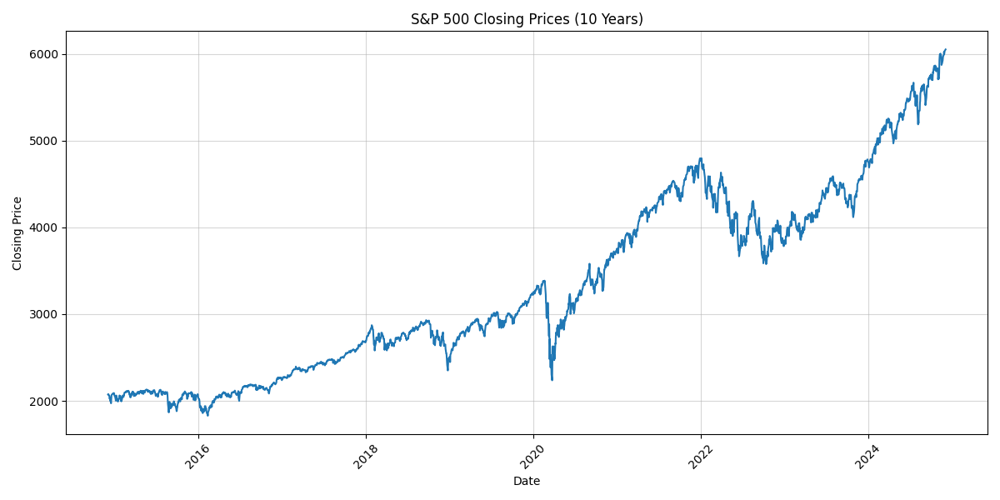

In [19]:
# !pip install ipympl
import yfinance as yf
import matplotlib.pyplot as plt

# Required for interactive plots in Jupyter Notebook
%matplotlib widget

# Download S&P 500 data for the past 10 years
data = yf.download("^GSPC", period="10y")

# ---------- create plot ------------
plt.figure(figsize=(12, 6))
plt.plot(data.index, data['Close'])

# customize plot
plt.title('S&P 500 Closing Prices (10 Years)')
plt.xlabel('Date')
plt.ylabel('Closing Price')
plt.grid(True, alpha=0.5)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

Support for third party widgets will remain active for the duration of the session. To disable support:

In [13]:
from google.colab import output
output.disable_custom_widget_manager()

## Exercise 8: Interactive Data Exploration with Plotly on Flight Delays Dataset

### Objective:

Use Plotly to create an interactive scatter plot to explore a large dataset of flight delays, focusing on the relationship between the delay duration and the time of the day.

### Dataset URL

[Flight Delay Data](https://www.transtats.bts.gov/OT_Delay/OT_DelayCause1.asp?pn=1)
### Instructions

*  Download the flight delay dataset from the provided URL, focusing on a single year of data for a comprehensive yet manageable size.
*  Load the data into a pandas DataFrame.
*  Import the necessary components from plotly.
*  Create an interactive scatter plot with the time of the day on the x-axis and delay duration on the y-axis.
*  Color-code the points based on the airline.
*  Add hover-over text displaying the flight number, departure, and arrival cities.
*  Customize the layout, including a title, axis labels, and a legend.


In [14]:
# !unzip /content/T_ONTIME_REPORTING_20241203_145616.zip
df_flights = pd.read_csv('/content/T_ONTIME_REPORTING.csv')
df_flights.head()

,FL_DATE,OP_CARRIER_AIRLINE_ID,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_CITY_NAME,DEST_AIRPORT_ID,DEST_CITY_NAME,DEP_TIME,DEP_DELAY_NEW
0,12/1/2023 12:00:00 AM,19393,1,11259,"Dallas, TX",12191,"Houston, TX",703.0,3.0
1,12/1/2023 12:00:00 AM,19393,1,12191,"Houston, TX",12206,"Harlingen/San Benito, TX",901.0,1.0
2,12/1/2023 12:00:00 AM,19393,100,14747,"Seattle, WA",14893,"Sacramento, CA",604.0,34.0
3,12/1/2023 12:00:00 AM,19393,100,14893,"Sacramento, CA",14908,"Santa Ana, CA",827.0,17.0
4,12/1/2023 12:00:00 AM,19393,1001,11292,"Denver, CO",12892,"Los Angeles, CA",1446.0,6.0


In [15]:
# convert departure time to hh:mm
df_flights['DEP_TIME'] = pd.to_datetime(df_flights['DEP_TIME'], format='%H%M', errors='coerce').dt.time

# interactive scatter plot
fig = px.scatter(df_flights,
                  x='DEP_TIME',
                  y='DEP_DELAY_NEW',
                  color='OP_CARRIER_AIRLINE_ID',
                  hover_data=['OP_CARRIER_FL_NUM', 'ORIGIN_CITY_NAME', 'DEST_CITY_NAME'],
                  title='flight delays vs. departure time in US (December 2023)')

# Customize the layout
fig.update_layout(xaxis_title='departure time',
                  yaxis_title='arrival delay (minutes)',
                  legend_title='airline')

fig.show()